In [11]:
import pandas as pd
import torchaudio
from pathlib import Path
import sys
import numpy as np
import random
import torch
import numpy as np

#set random seeds for reproducibility
SEED = 0
torch.manual_seed(SEED)
random.seed(SEED)
np.random.seed(SEED)

repo_root = Path.cwd().parent
sys.path.insert(0, str(repo_root / "src"))

model_path = repo_root / 'models' / 'GRU_VAD' /'tiny_vad_best.pth'

from utils.audio_dataset_loader import (
    load_ears_dataset,
    load_noizeus_dataset,
    create_audio_pairs,
    preprocess_audio
)
from deep_learning.gtcrn import GTCRN
from utils.generate_and_save_spectrogram import generate_and_save_spectrogram
from dsp_algorithms.mband_var import mband

In [12]:
# Load GTCRN model
device = torch.device("cpu")
gtcrn_model = GTCRN().eval()
ckpt_path = repo_root / "src" / "deep_learning" / "gtcrn" / "gtcrn_main" / "checkpoints" / "model_trained_on_dns3.tar"
ckpt = torch.load(ckpt_path, map_location=device)
gtcrn_model.load_state_dict(ckpt['model'])


<All keys matched successfully>

In [13]:
noise_path = repo_root / "sound_data" / "raw" / "NOIZEUS_NOISE_DATASET"
babble_noise_path = noise_path / "cafeteria_babble.wav"
street_noise_path = noise_path / "Street Noise_downtown.wav"

In [14]:
clean_sound_path = repo_root / "sound_data" / "raw" / "EARS_DATASET" / "p092"
clean_sound_file = clean_sound_path / "emo_amazement_freeform.wav"

In [15]:
snr_dB = 0

clean_waveform, noise_waveform, noisy_speech, clean_sr = preprocess_audio(
    clean_speech=clean_sound_file, 
    noisy_audio=street_noise_path, 
    snr_db=snr_dB
)

Clean speech duration: 16.81s (268908 samples)
Noise duration: 30.55s (488800 samples)
Noise truncated to random frame starting at sample 27298


c:\Users\gabi\Documents\University\Uni2025\Investigation\PROJECT-25P85\.venv\Lib\site-packages\torchaudio\_backend\utils.py:213: UserWarning: In 2.9, this function's implementation will be changed to use torchaudio.load_with_torchcodec` under the hood. Some parameters like ``normalize``, ``format``, ``buffer_size``, and ``backend`` will be ignored. We recommend that you port your code to rely directly on TorchCodec's decoder instead: https://docs.pytorch.org/torchcodec/stable/generated/torchcodec.decoders.AudioDecoder.html#torchcodec.decoders.AudioDecoder.
  warnings.warn(


In [16]:
ss_alone_enh, ss_fs = mband(
    noisy_audio=noisy_speech,
    fs=clean_sr,
    Nband=4,
    Freq_spacing='linear',
    FRMSZ=20,
    OVLP=50,
    AVRGING=1,
    Noisefr=1,
    FLOOR=0.002,
    VAD=1,
)

Using device: cpu


In [17]:
# GTCRN inference
input_stft = torch.stft(noisy_speech, 512, 256, 512, torch.hann_window(512).pow(0.5), return_complex=True)
input_stft = torch.view_as_real(input_stft)  # Convert to (F, T, 2)
with torch.no_grad():
    output_stft = gtcrn_model(input_stft[None])[0]  # Add batch dimension: (1, F, T, 2)
output_stft = torch.complex(output_stft[..., 0], output_stft[..., 1])  # Convert back to complex
gtcrn_enhanced_speech = torch.istft(output_stft, 512, 256, 512, torch.hann_window(512).pow(0.5)).detach().cpu().numpy()

ss_enh, ss_fs = mband(
    noisy_audio=torch.from_numpy(gtcrn_enhanced_speech).clone(),
    fs=clean_sr,
    Nband=8,  # changed from n=8 to n=4 (previous is on poster setting)
    Freq_spacing='linear',
    FRMSZ=20,
    OVLP=75,
    AVRGING=1,
    Noisefr=1,
    FLOOR=0.7,
    VAD=1,
)

gtcrn_enhanced_speech = ss_enh


Using device: cpu


SIDE-BY-SIDE COMPARISON

Audio lengths before trimming:
  noisy:              268908
  MBAND:              268800
  GTCRN + MBAND:      268800
  clean:              268908

Trimmed to: 268800 samples (16.80s)


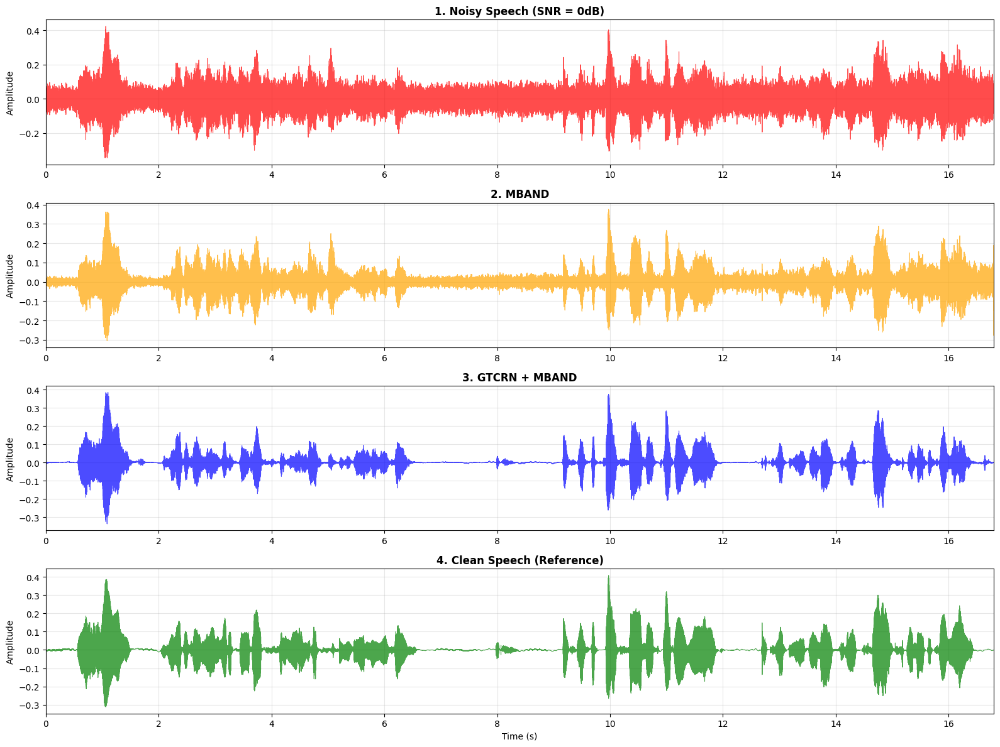


AUDIO PLAYBACK COMPARISON
NOISY SPEECH (0dB SNR):



MBAND:



GTCRN + MBAND:



CLEAN SPEECH (Reference):


In [18]:
import IPython.display as ipd
import matplotlib.pyplot as plt

print("="*80)
print("SIDE-BY-SIDE COMPARISON")
print("="*80)

# Prepare audio signals for comparison
noisy_compare = noisy_speech.clone().squeeze(0)
mband_compare = ss_alone_enh.clone().squeeze(0)
gtcrn_mband_compare = gtcrn_enhanced_speech.clone().squeeze(0)
clean_compare = clean_waveform.clone().squeeze(0)

fs = 16000

print(f"\nAudio lengths before trimming:")
print(f"  noisy:              {len(noisy_compare)}")
print(f"  MBAND:              {len(mband_compare)}")
print(f"  GTCRN + MBAND:      {len(gtcrn_mband_compare)}")
print(f"  clean:              {len(clean_compare)}")

# Trim to shortest length
min_len = min(
    len(noisy_compare), 
    len(mband_compare),
    len(gtcrn_mband_compare),
    len(clean_compare)
)

noisy_compare = noisy_compare[:min_len]
mband_compare = mband_compare[:min_len]
gtcrn_mband_compare = gtcrn_mband_compare[:min_len]
clean_compare = clean_compare[:min_len]

print(f"\nTrimmed to: {min_len} samples ({min_len/fs:.2f}s)")

# Create 4-panel comparison plot
fig, axes = plt.subplots(4, 1, figsize=(16, 12))
time_axis = np.arange(min_len) / fs

# 1. Noisy
axes[0].plot(time_axis, noisy_compare.numpy(), 'r', alpha=0.7, linewidth=0.8)
axes[0].set_title(f'1. Noisy Speech (SNR = {snr_dB}dB)', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Amplitude')
axes[0].grid(True, alpha=0.3)
axes[0].set_xlim(0, min_len/fs)

# 2. MBAND
axes[1].plot(time_axis, mband_compare.numpy(), 'orange', alpha=0.7, linewidth=0.8)
axes[1].set_title('2. MBAND', fontsize=12, fontweight='bold')
axes[1].set_ylabel('Amplitude')
axes[1].grid(True, alpha=0.3)
axes[1].set_xlim(0, min_len/fs)

# 3. GTCRN + MBAND
axes[2].plot(time_axis, gtcrn_mband_compare.numpy(), 'b', alpha=0.7, linewidth=0.8)
axes[2].set_title('3. GTCRN + MBAND', fontsize=12, fontweight='bold')
axes[2].set_ylabel('Amplitude')
axes[2].grid(True, alpha=0.3)
axes[2].set_xlim(0, min_len/fs)

# 4. Clean reference
axes[3].plot(time_axis, clean_compare.numpy(), 'g', alpha=0.7, linewidth=0.8)
axes[3].set_title('4. Clean Speech (Reference)', fontsize=12, fontweight='bold')
axes[3].set_ylabel('Amplitude')
axes[3].set_xlabel('Time (s)')
axes[3].grid(True, alpha=0.3)
axes[3].set_xlim(0, min_len/fs)

plt.tight_layout()
plt.show()

# Audio playback comparison
print("\n" + "="*80)
print("AUDIO PLAYBACK COMPARISON")
print("="*80)

print("NOISY SPEECH (0dB SNR):")
display(ipd.Audio(noisy_compare.numpy(), rate=fs))

print("\nMBAND:")
display(ipd.Audio(mband_compare.numpy(), rate=fs))

print("\nGTCRN + MBAND:")
display(ipd.Audio(gtcrn_mband_compare.numpy(), rate=fs))

print("\nCLEAN SPEECH (Reference):")
display(ipd.Audio(clean_compare.numpy(), rate=fs))

Generating and saving spectrograms...
Processing audio: tensor_audio
  Duration: 16.80s
  Sample rate: 16000Hz
  Channels: 1
Generating mel spectrogram...

Spectrogram generated successfully!
  Audio source: tensor_audio
  Parameters: 128 mels, 512 hop, 1024 FFT
  Duration: 16.80s at 16000Hz
  Max frequency: 8000Hz
  Output files:
    PNG: spectrograms\comparison\clean_speech_spectrogram.png
    PDF: spectrograms\comparison\clean_speech_spectrogram.pdf
    SVG: spectrograms\comparison\clean_speech_spectrogram.svg


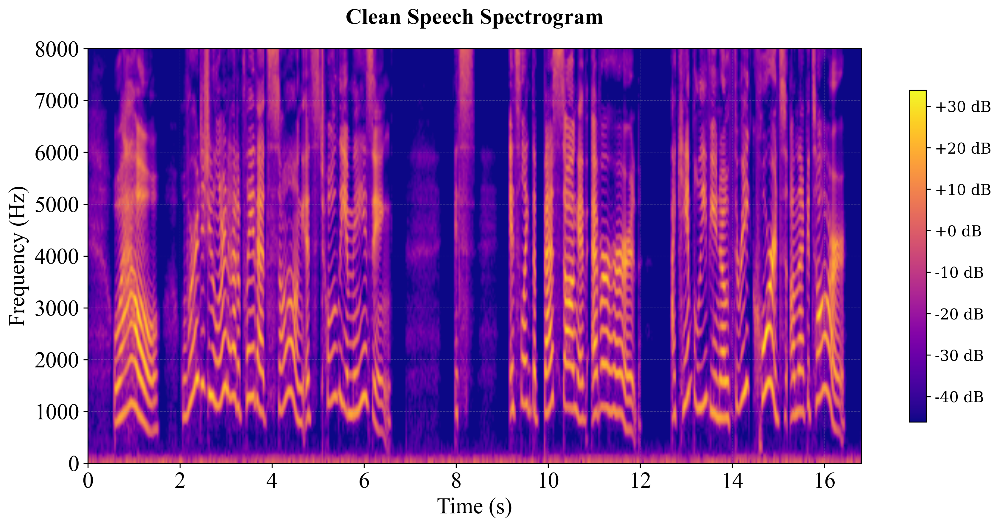

Processing audio: tensor_audio
  Duration: 16.80s
  Sample rate: 16000Hz
  Channels: 1
Generating mel spectrogram...

Spectrogram generated successfully!
  Audio source: tensor_audio
  Parameters: 128 mels, 512 hop, 1024 FFT
  Duration: 16.80s at 16000Hz
  Max frequency: 8000Hz
  Output files:
    PNG: spectrograms\comparison\noisy_spectrogram.png
    PDF: spectrograms\comparison\noisy_spectrogram.pdf
    SVG: spectrograms\comparison\noisy_spectrogram.svg


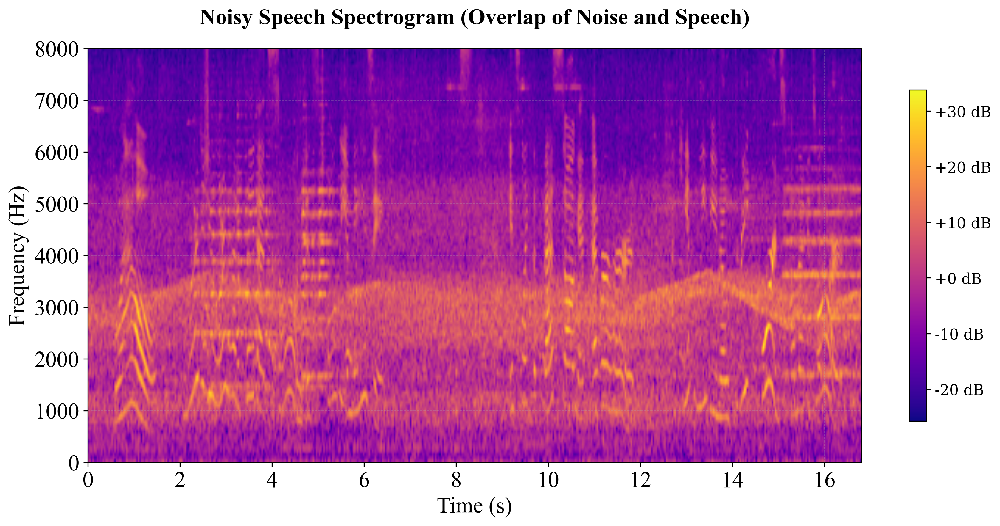

Processing audio: tensor_audio
  Duration: 16.80s
  Sample rate: 16000Hz
  Channels: 1
Generating mel spectrogram...

Spectrogram generated successfully!
  Audio source: tensor_audio
  Parameters: 128 mels, 512 hop, 1024 FFT
  Duration: 16.80s at 16000Hz
  Max frequency: 8000Hz
  Output files:
    PNG: spectrograms\comparison\gtcrn_spectrogram.png
    PDF: spectrograms\comparison\gtcrn_spectrogram.pdf
    SVG: spectrograms\comparison\gtcrn_spectrogram.svg


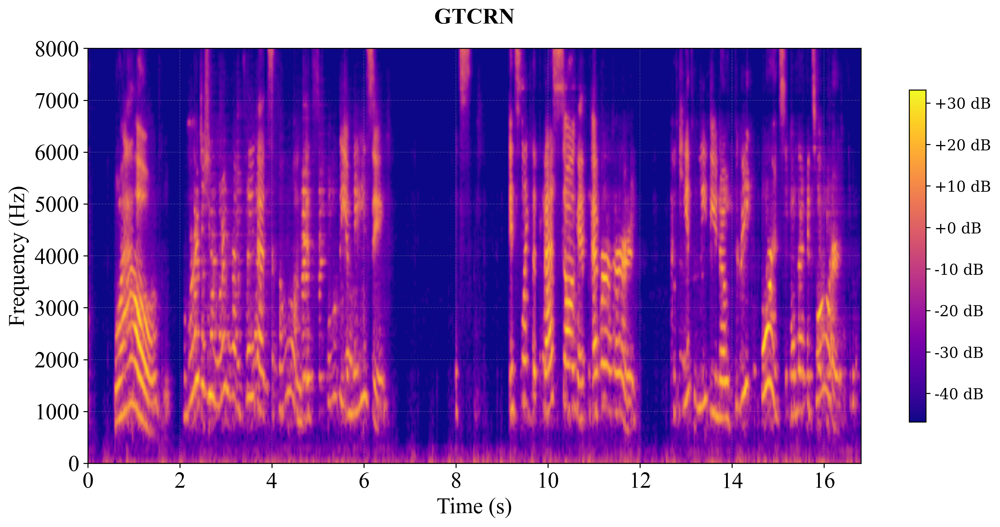

Processing audio: tensor_audio
  Duration: 16.80s
  Sample rate: 16000Hz
  Channels: 1
Generating mel spectrogram...

Spectrogram generated successfully!
  Audio source: tensor_audio
  Parameters: 128 mels, 512 hop, 1024 FFT
  Duration: 16.80s at 16000Hz
  Max frequency: 8000Hz
  Output files:
    PNG: spectrograms\comparison\mband_alone_spectrogram.png
    PDF: spectrograms\comparison\mband_alone_spectrogram.pdf
    SVG: spectrograms\comparison\mband_alone_spectrogram.svg


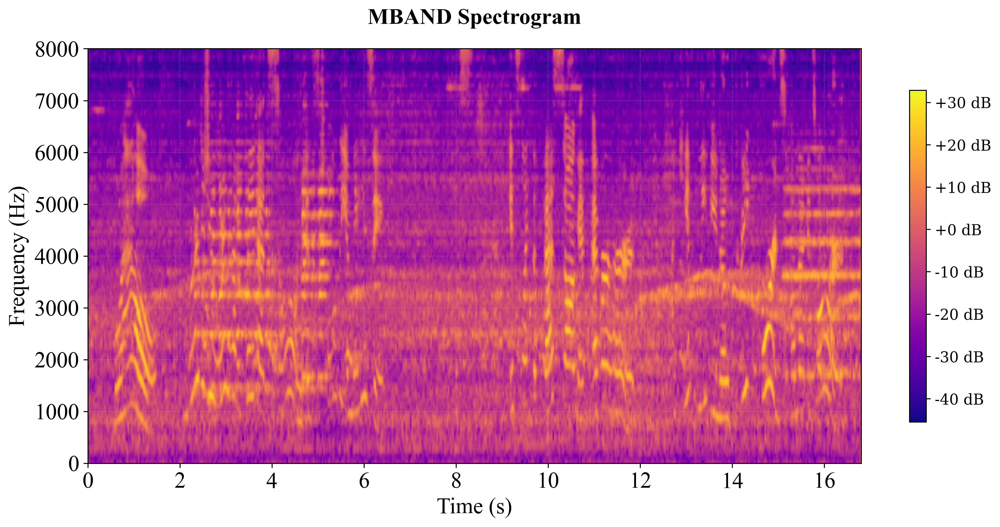

Processing audio: tensor_audio
  Duration: 16.80s
  Sample rate: 16000Hz
  Channels: 1
Generating mel spectrogram...

Spectrogram generated successfully!
  Audio source: tensor_audio
  Parameters: 128 mels, 512 hop, 1024 FFT
  Duration: 16.80s at 16000Hz
  Max frequency: 8000Hz
  Output files:
    PNG: spectrograms\comparison\gtcrnmband_spectrogram.png
    PDF: spectrograms\comparison\gtcrnmband_spectrogram.pdf
    SVG: spectrograms\comparison\gtcrnmband_spectrogram.svg


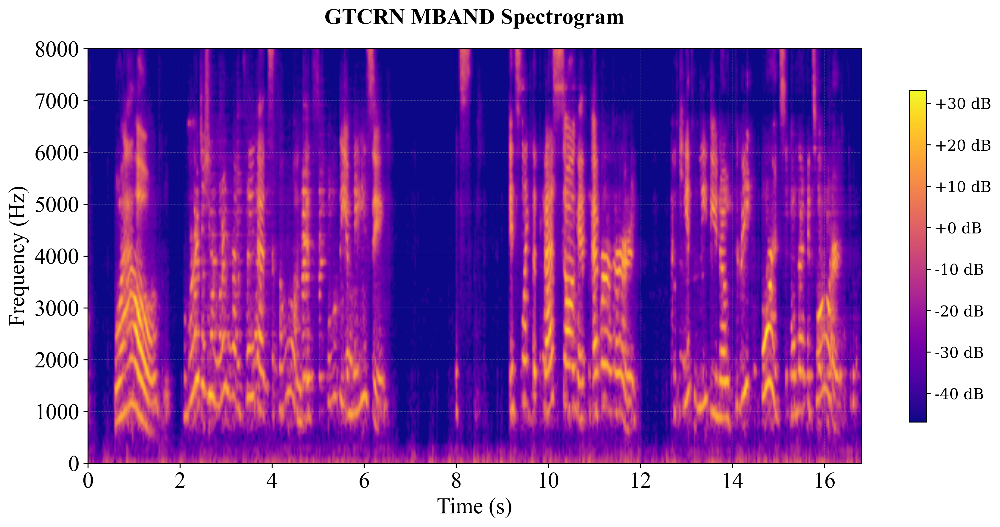

Spectrograms generated, saved, and displayed.


In [19]:
# Use the audio waveforms from earlier
noisy_waveform = noisy_compare
clean_waveform_trimmed = clean_compare
mband_alone_waveform = mband_compare
gtcrnmband_waveform = gtcrn_mband_compare
sample_rate = 16000

# Generate and save spectrograms using the utility function
print("Generating and saving spectrograms...")
output_path = "spectrograms/comparison"

generate_and_save_spectrogram(
    waveform=clean_waveform_trimmed,
    sample_rate=sample_rate,
    output_image_path=output_path,
    output_file_name="clean_speech_spectrogram",
    title="Clean Speech Spectrogram",
    n_mels=128,
    hop_length=512,
    n_fft=1024,
    colormap='plasma',
    include_metadata_in_filename=False
)

ipd.display(ipd.Image(filename=f'{output_path}/clean_speech_spectrogram.png'))

generate_and_save_spectrogram(
    waveform=noisy_waveform,
    sample_rate=sample_rate,
    output_image_path=output_path,
    output_file_name="noisy_spectrogram",
    title="Noisy Speech Spectrogram (Overlap of Noise and Speech)",
    n_mels=128,
    hop_length=512,
    n_fft=1024,
    colormap='plasma',
    include_metadata_in_filename=False
)

ipd.display(ipd.Image(filename=f'{output_path}/noisy_spectrogram.png'))

generate_and_save_spectrogram(
    waveform=gtcrnmband_waveform,
    sample_rate=sample_rate,
    output_image_path=output_path,
    output_file_name="gtcrn_spectrogram",
    title="GTCRN",
    n_mels=128,
    hop_length=512,
    n_fft=1024,
    colormap='plasma',
    include_metadata_in_filename=False
)

ipd.display(ipd.Image(filename=f'{output_path}/gtcrn_spectrogram.png'))

generate_and_save_spectrogram(
    waveform=mband_alone_waveform,
    sample_rate=sample_rate,
    output_image_path=output_path,
    output_file_name="mband_alone_spectrogram",
    title="MBAND Spectrogram",
    n_mels=128,
    hop_length=512,
    n_fft=1024,
    colormap='plasma',
    include_metadata_in_filename=False
)

ipd.display(ipd.Image(filename=f'{output_path}/mband_alone_spectrogram.png'))

generate_and_save_spectrogram(
    waveform=gtcrnmband_waveform,
    sample_rate=sample_rate,
    output_image_path=output_path,
    output_file_name="gtcrnmband_spectrogram",
    title="GTCRN MBAND Spectrogram",
    n_mels=128,
    hop_length=512,
    n_fft=1024,
    colormap='plasma',
    include_metadata_in_filename=False
)

ipd.display(ipd.Image(filename=f'{output_path}/gtcrnmband_spectrogram.png'))

print("Spectrograms generated, saved, and displayed.")